## Purpose of the notebook

This notebook was made to mark and plot trials from participant dataframes. The function to mark trials has now been added to the pipeline for loading participant data. The functions for plotting trials and baseline change are in loading_utils, their functionality is shown further down. To get data used, run load_and_resample.py with saving raw data enabled.

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import pupilprep_utilities.loading_utils as load

participant_list = [200, 201, 202, 204, 205, 206, 207, 209, 210, 211, 212, 213]

In [ ]:
participant_id = 200
data_dir = "./results"
data_path = os.path.join(data_dir, str(participant_id) + "_full_data.csv")

data_df = pd.read_csv(data_path)
data_df_new = load.mark_trials(data_df)

In [8]:
data_df_new

,Unnamed: 0,Overall time Sec,Sequence time Sec,Experiment state,Sequence index,Sequences count,Excitation index,Excitation label - Left,Excitation label - Right,Left - Is found,...,Right - Distance from focus,Right - Leds temp,Eye,Phase,Session id,Trial phase,Trial type,Trial no,Trial time Sec,Stim eye - Size Mm
0,0,0.005,0.005,Active,1,26,2.0,dark,baseline,False,...,NaN,NaN,R,Adaptation,0,Adaptation,N/A,N/A,N/A,NaN
1,1,0.011,0.012,Active,1,26,2.0,dark,baseline,False,...,NaN,NaN,R,Adaptation,0,Adaptation,N/A,N/A,N/A,NaN
2,2,0.013,0.014,Active,1,26,2.0,dark,baseline,False,...,59.19524,NaN,R,Adaptation,0,Adaptation,N/A,N/A,N/A,7.84605
3,3,0.017,0.018,Active,1,26,2.0,dark,baseline,True,...,NaN,NaN,R,Adaptation,0,Adaptation,N/A,N/A,N/A,NaN
4,4,0.037,0.038,Active,1,26,2.0,dark,baseline,False,...,59.45891,NaN,R,Adaptation,0,Adaptation,N/A,N/A,N/A,7.83411
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1018496,42735,731.016,19.366,Active,26,26,3852.0,dark,baseline,True,...,NaN,NaN,R,pre-stim,28,post-stim,lms,579,19.36,NaN
1018497,42736,731.017,19.366,Active,26,26,3852.0,dark,baseline,False,...,109.41843,NaN,R,pre-stim,28,post-stim,lms,579,19.361,7.03316
1018498,42737,731.051,19.401,Active,26,26,3852.0,dark,baseline,True,...,110.40439,NaN,R,pre-stim,28,post-stim,lms,579,19.395,7.03606
1018499,42738,731.085,19.434,Active,26,26,3852.0,dark,baseline,True,...,110.61753,NaN,R,pre-stim,28,post-stim,lms,579,19.429,7.04224


In [2]:
def calculate_change_from_baseline(data_df):
    data_df["Baseline change %"] = ["N/A"] * len(data_df)
    for i in data_df["Trial no"].unique()[1::]:
        trial_df = data_df[(data_df["Trial no"] == i)].copy()
        baseline = trial_df["Stim eye - Size Mm"][trial_df["Trial time Sec"] < 0].mean()
        data_df.loc[(data_df["Trial no"] == i), "Baseline change %"] = (
            (trial_df["Stim eye - Size Mm"] - baseline) * 100 / baseline
        )
    return data_df

In [3]:
def plot_trials(data_df_new, participant_id):
    fig, axs = plt.subplots(1, 5, figsize=(24, 5))
    for i, trial_type in enumerate(
        sorted(data_df_new["Trial type"][data_df_new["Trial type"].notna()].unique())
    ):
        axs[i].axvspan(0, 5, alpha=0.1, color="green")
        sns.scatterplot(
            ax=axs[i],
            data=data_df_new[data_df_new["Trial type"] == trial_type],
            x="Trial time Sec",
            y="Stim eye - Size Mm",
            hue="Trial no",
            s=0.5,
        )
        axs[i].set_title(trial_type)
        if i > 0:
            axs[i].set_ylabel("")
        axs[i].legend([], [], frameon=False)
        axs[i].set_ylim([0, 10])
    fig.suptitle(f"Pupil size per trial for participant {participant_id}")
    plt.tight_layout()
    plt.show()

In [4]:
def plot_baseline_change(data_df_new, participant_id):
    fig, axs = plt.subplots(1, 5, figsize=(24, 5))
    for i, trial_type in enumerate(
        sorted(data_df_new["Trial type"][data_df_new["Trial type"].notna()].unique())
    ):
        axs[i].axvspan(0, 5, alpha=0.1, color="green")
        sns.scatterplot(
            ax=axs[i],
            data=data_df_new[data_df_new["Trial type"] == trial_type],
            x="Trial time Sec",
            y="Baseline change %",
            hue="Trial no",
            s=0.5,
        )
        axs[i].set_title(trial_type)
        if i > 0:
            axs[i].set_ylabel("")
        axs[i].legend([], [], frameon=False)
        axs[i].set_ylim([-50, 50])
    fig.suptitle(
        f"Change in stimulated pupil size from baseline average per trial for participant {participant_id}"
    )
    plt.tight_layout()
    plt.show()

In [8]:
participant_list = [200, 201, 202, 204, 205, 206, 207, 209, 210, 211, 212, 213]

In [6]:
data_dir = "./results/new/"
for participant_id in participant_list:
    data_path = os.path.join(data_dir, str(participant_id) + "_recording_data.csv")
    data_df = pd.read_csv(data_path)
    # data_df_new = load.mark_trials(data_df)
    data_df_new = calculate_change_from_baseline(data_df)
    data_df_new.to_csv("./results/dfs_marked/" + str(participant_id) + "_full_data.csv")
    data_df = []
    data_df_new = []

C:\Users\larea\AppData\Local\Temp\ipykernel_20252\362608487.py:4: DtypeWarning: Columns (32) have mixed types. Specify dtype option on import or set low_memory=False.
  data_df_new = pd.read_csv(data_path,usecols =['Trial type','Trial time Sec','Trial no','Stim eye - Size Mm','Baseline change %'])


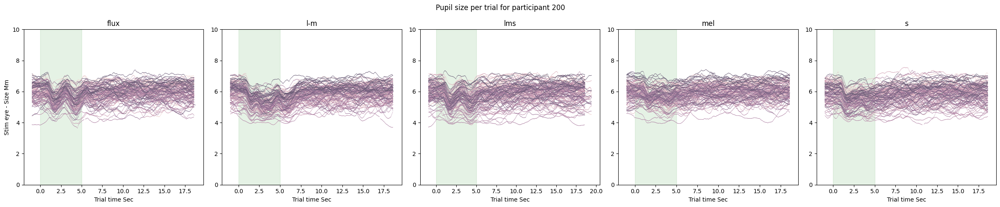

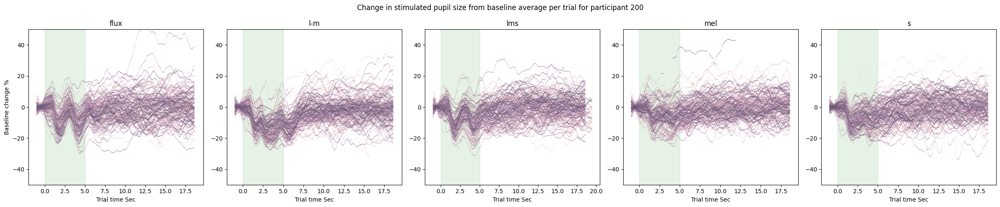

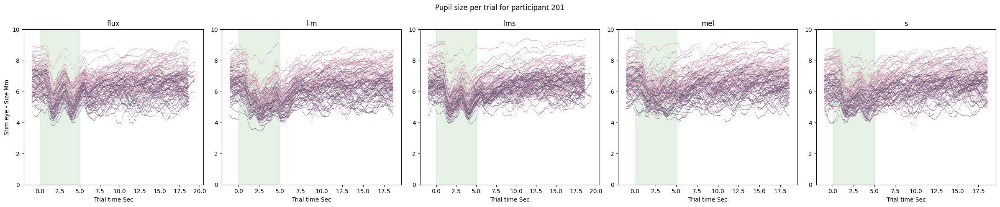

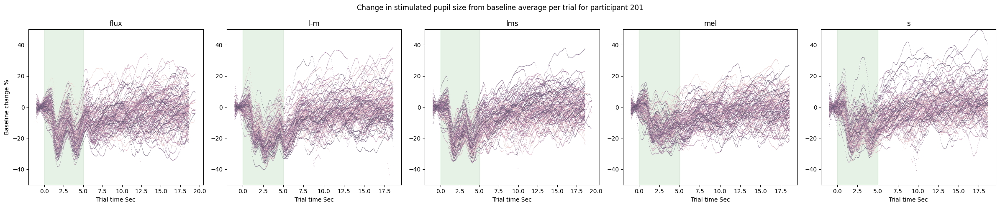

C:\Users\larea\AppData\Local\Temp\ipykernel_20252\362608487.py:4: DtypeWarning: Columns (32) have mixed types. Specify dtype option on import or set low_memory=False.
  data_df_new = pd.read_csv(data_path,usecols =['Trial type','Trial time Sec','Trial no','Stim eye - Size Mm','Baseline change %'])


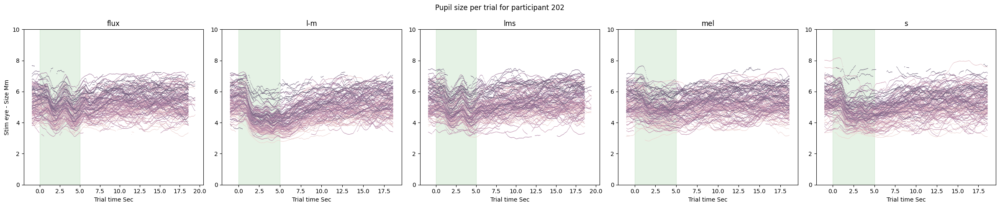

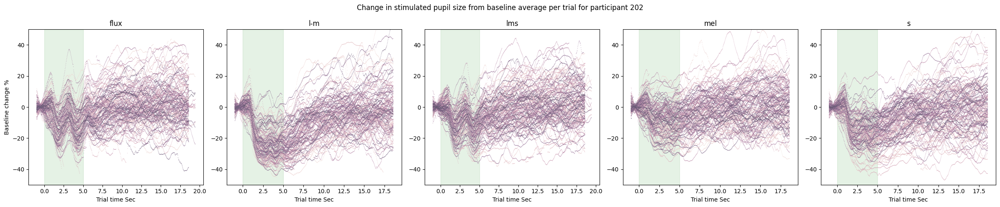

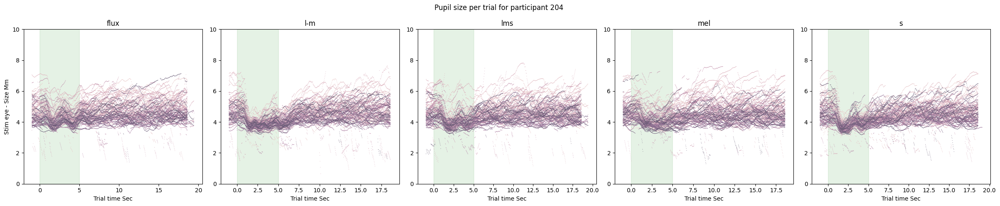

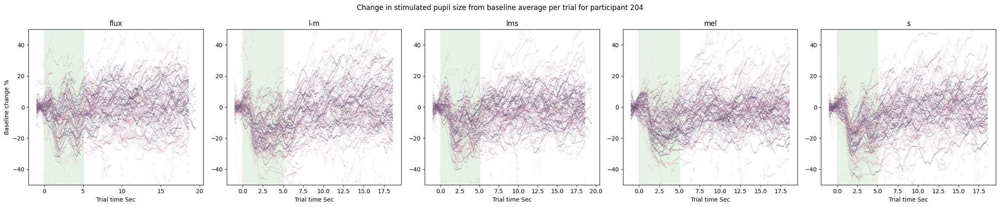

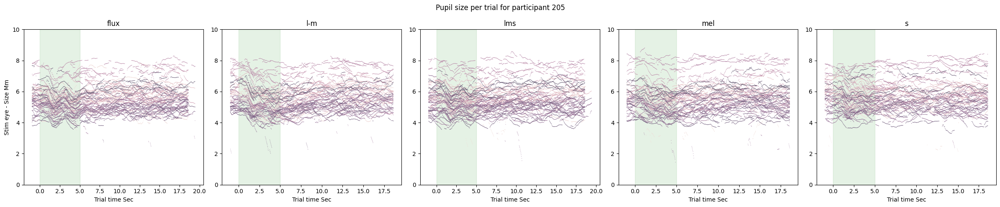

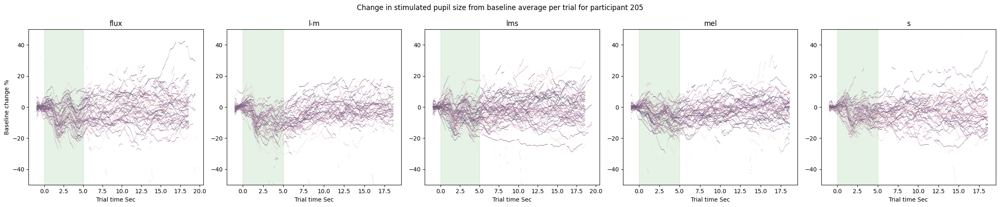

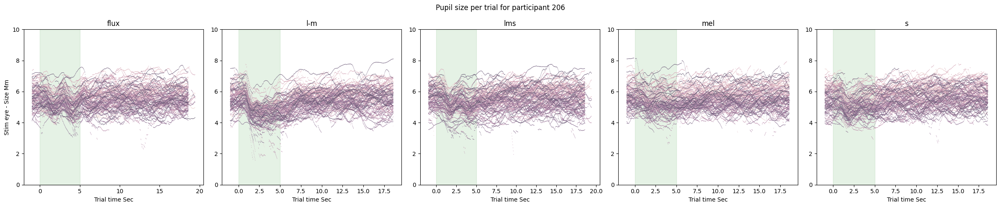

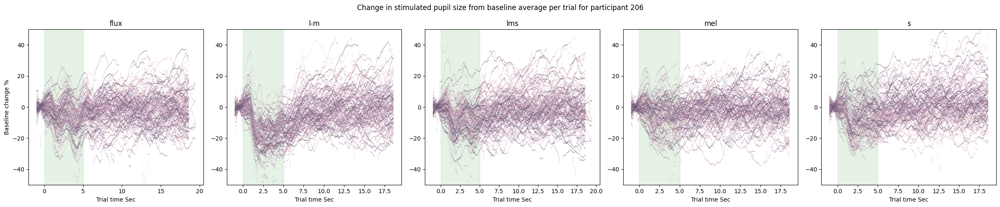

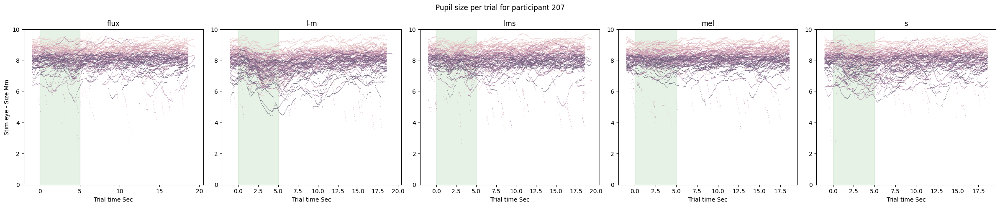

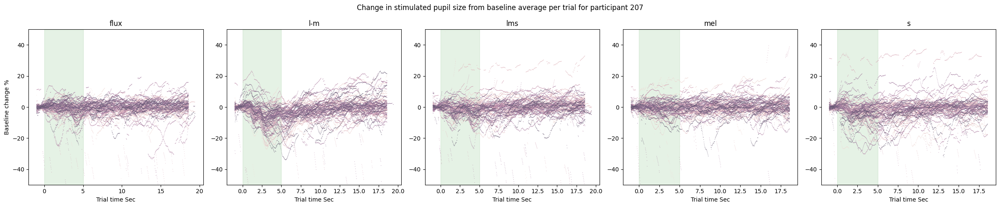

C:\Users\larea\AppData\Local\Temp\ipykernel_20252\362608487.py:4: DtypeWarning: Columns (32) have mixed types. Specify dtype option on import or set low_memory=False.
  data_df_new = pd.read_csv(data_path,usecols =['Trial type','Trial time Sec','Trial no','Stim eye - Size Mm','Baseline change %'])


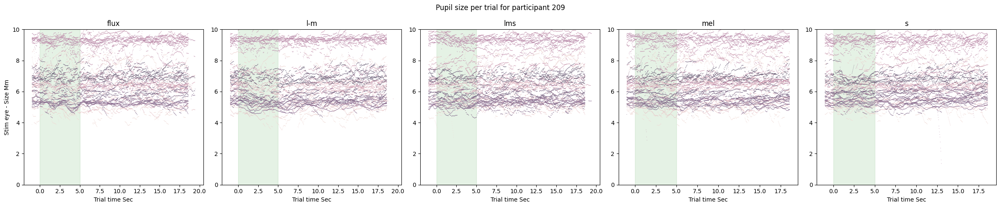

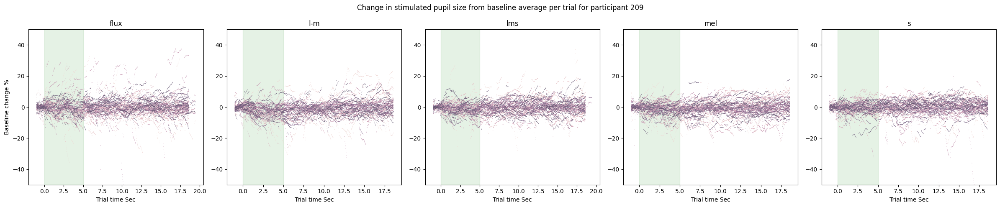

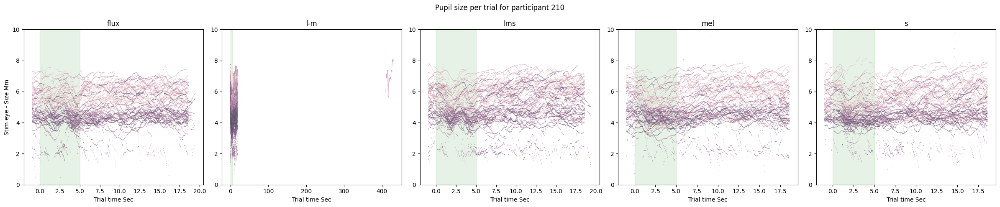

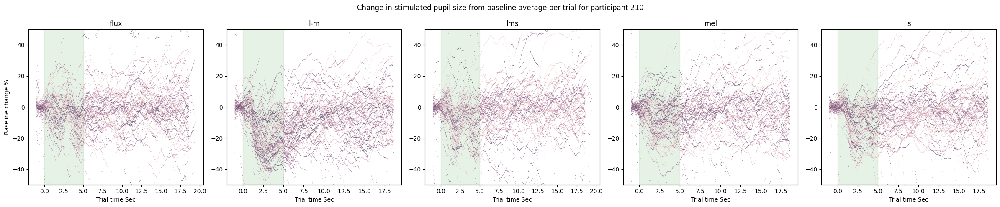

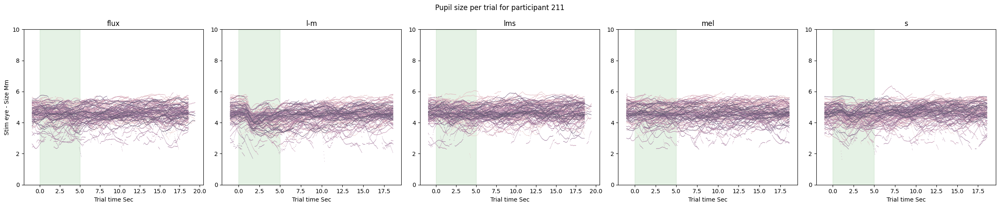

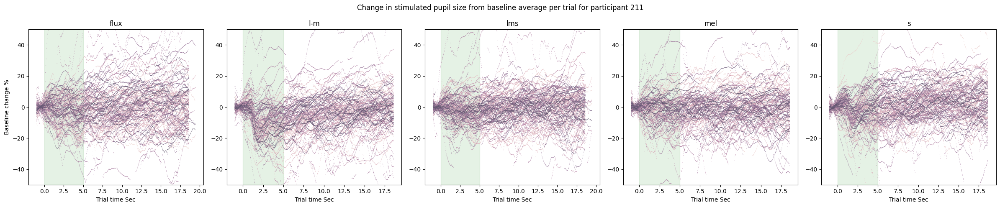

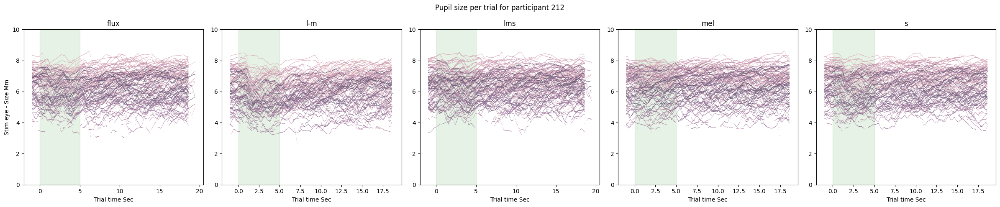

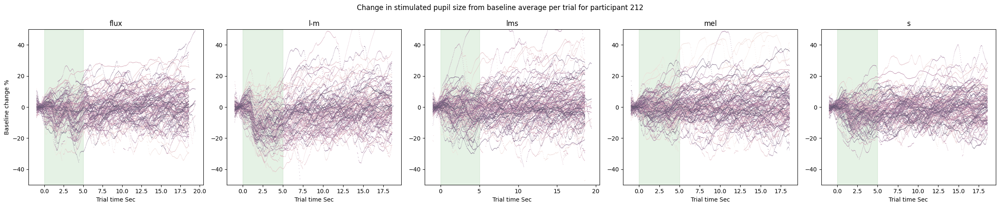

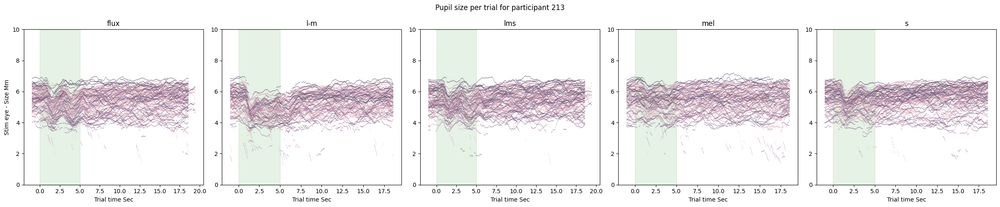

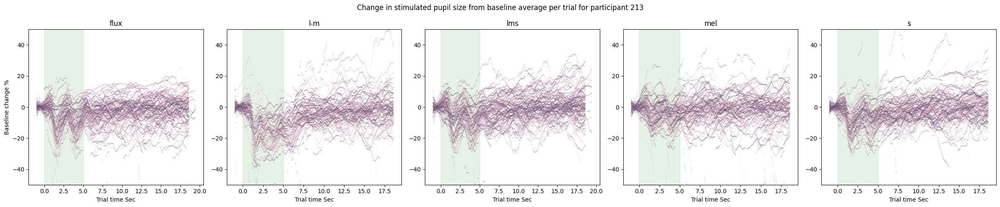

In [9]:
data_dir = "./results/dfs_marked"
for participant_id in participant_list:
    data_path = os.path.join(data_dir, str(participant_id) + "_full_data.csv")
    data_df_new = pd.read_csv(
        data_path,
        usecols=[
            "Trial type",
            "Trial time Sec",
            "Trial no",
            "Stim eye - Size Mm",
            "Baseline change %",
        ],
    )
    data_df_new["Trial no"] = pd.to_numeric(data_df_new["Trial no"], errors="coerce")
    data_df_new["Stim eye - Size Mm"] = pd.to_numeric(
        data_df_new["Stim eye - Size Mm"], errors="coerce"
    )
    data_df_new["Trial time Sec"] = pd.to_numeric(
        data_df_new["Trial time Sec"], errors="coerce"
    )
    data_df_new["Baseline change %"] = pd.to_numeric(
        data_df_new["Baseline change %"], errors="coerce"
    )

    plot_trials(data_df_new, participant_id)
    plot_baseline_change(data_df_new, participant_id)

    data_df_new = []

Next step will be to identify and at least temporarily reject trials with long stretches of NaN values in signal in the areas of interest. The remaining trials can be resampled with interpolation to enable further processing.